<a href="https://colab.research.google.com/github/Silambarasan92-spec/project-_2_Item-demand-Forecasting-/blob/main/Project_2_Item_demand_Forecasting_by_Silambarasan_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***Accurate forecasting of demand can help the manufacturers to maintain appropriate stock which results in reduction in loss due to product not being sold and also reduces the opportunity cost (i.e. higher demand but less availability => opportunity lost) Despite such relevance, manufacturers have difficulty choosing which forecast model is the best for their use case. In this project, historical sales data corresponding to multiple(25) items sold in 10 stores are provided and participants are expected to come up with a best model to predict the future demand for products which results in maximum profit for the manufacturer. Predict the demand for the next 3 months at the item level (i.e. all the stores combined).***






**Data fields**

- **date** - Date of the sale data. There are no holiday effects or store closures.
- **store** - Store ID
- **item** - Item ID
- **sales** - Number of items sold at a particular store on a particular date.


# ***In this project, the goal is to forecast 3-month sales for 50 different products in 10 different stores when given 5 years of store item sales data*** 

In [2]:
#import libraries
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn import metrics
import matplotlib.pyplot as plt
%matplotlib inline
from time import time

import warnings
warnings.filterwarnings("ignore")

In [5]:
# Read the dataset
dataset = pd.read_csv("train 2_forcasting.csv")
dataset

,date,store,item,sales
0,1/1/2013,1,1,13
1,1/2/2013,1,1,11
2,1/3/2013,1,1,14
3,1/4/2013,1,1,13
4,1/5/2013,1,1,10
...,...,...,...,...
912995,12/27/2017,10,50,63
912996,12/28/2017,10,50,59
912997,12/29/2017,10,50,74
912998,12/30/2017,10,50,62


### **DATA CLEANING**







In [6]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 913000 entries, 0 to 912999
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   date    913000 non-null  object
 1   store   913000 non-null  int64 
 2   item    913000 non-null  int64 
 3   sales   913000 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 27.9+ MB


***DATA HAS NO MISSING AND ZERO NULL VALUES FOR ALL COLUMNS, SO NO NEED OF IMPUTE AND DROP THE DATA***

In [7]:
#change the date column datatype object to datetime 
from datetime import datetime, timedelta, date
dataset['date'] = pd.to_datetime(dataset['date'])

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 913000 entries, 0 to 912999
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    913000 non-null  datetime64[ns]
 1   store   913000 non-null  int64         
 2   item    913000 non-null  int64         
 3   sales   913000 non-null  int64         
dtypes: datetime64[ns](1), int64(3)
memory usage: 27.9 MB


***Understanding Dataset***

In [9]:
dataset.isnull().sum() # no null values and no duplicate rows

date     0
store    0
item     0
sales    0
dtype: int64

In [10]:
dataset['store'].unique()
#dataset.store.unique()


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])

***To Check the number of unique values in the dataset***

In [11]:
dataset.store.nunique()

10

In [12]:
dataset.groupby(["store"]).agg({"sales": ["count","sum", "mean", "median", "std", "min", "max"]})

sales                                               
       count      sum       mean median        std min  max
store                                                      
1      91300  4315603  47.268379   44.0  24.006252   1  155
2      91300  6120128  67.033165   62.0  33.595810   3  231
3      91300  5435144  59.530602   55.0  29.974102   3  196
4      91300  5012639  54.902946   51.0  27.733097   4  186
5      91300  3631016  39.770164   37.0  20.365757   2  130
6      91300  3627670  39.733516   37.0  20.310451   0  134
7      91300  3320009  36.363735   34.0  18.684825   1  122
8      91300  5856169  64.142048   60.0  32.231751   4  204
9      91300  5025976  55.049025   51.0  27.832186   4  195
10     91300  5360158  58.709288   54.0  29.554994   3  187

In [13]:
dataset.item.unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50])

In [14]:
dataset.item.nunique()

50

In [15]:
dataset.groupby(["item"]).agg({"sales": ["count","sum", "mean", "median", "std", "min", "max"]})

sales                                               
      count      sum       mean median        std min  max
item                                                      
1     18260   401384  21.981599   21.0   8.468922   1   59
2     18260  1069564  58.574151   56.0  20.093015   9  150
3     18260   669087  36.642223   35.0  13.179441   7  104
4     18260   401907  22.010241   21.0   8.403898   0   66
5     18260   335230  18.358708   18.0   7.265167   1   50
6     18260  1068281  58.503888   56.0  20.174898  11  148
7     18260  1068777  58.531051   56.0  20.146002  11  141
8     18260  1405108  76.950055   74.0  26.130697  15  181
9     18260   938379  51.389869   49.5  17.790158   6  134
10    18260  1337133  73.227437   70.0  24.823725  14  175
11    18260  1271925  69.656353   67.0  23.744732  11  170
12    18260  1271534  69.634940   67.0  23.738663  12  170
13    18260  1539621  84.316594   81.0  28.311031  20  210
14    18260  1071531  58.681873   56.0  20.079860  12  152
15    18260  1607442  88.030778   85.0  29.522852  17  231
16    18260   468480  25.656079   25.0   9.603270   2   70
17    18260   602486  32.994852   32.0  11.967610   4   83
18    18260  1538876  84.275794   81.0  28.430621  18  208
19    18260   736892  40.355531   39.0  14.332645   5   99
20    18260   867641  47.515936   46.0  16.490487   9  127
21    18260   736190  40.317087   39.0  14.338006   7  109
22    18260  1469971  80.502245   78.0  27.118163  14  214
23    18260   534979  29.297864   28.0  10.819549   3   81
24    18260  1205975  66.044633   64.0  22.531555  14  156
25    18260  1473334  80.686418   78.0  27.238817  18  193
26    18260   869981  47.644085   46.0  16.723912   8  119
27    18260   402628  22.049726   21.0   8.461641   1   59
28    18260  1604713  87.881325   85.0  29.501781  16  206
29    18260  1271240  69.618839   67.0  23.635631  15  173
30    18260   736554  40.337021   39.0  14.363331   5  115
31    18260  1070845  58.644304   57.0  20.104705  10  159
32    18260   803107  43.981763   42.0  15.574556   5  119
33    18260  1270183  69.560953   67.0  23.718343  15  169
34    18260   469935  25.735761   25.0   9.617910   2   79
35    18260  1201541  65.801807   63.0  22.461990  12  168
36    18260  1406548  77.028916   74.0  26.067440  16  188
37    18260   534258  29.258379   28.0  10.771547   3   74
38    18260  1470330  80.521906   77.0  27.141799  15  188
39    18260   801311  43.883406   42.0  15.511550   7  112
40    18260   534094  29.249398   28.0  10.822959   3   74
41    18260   401759  22.002136   21.0   8.402470   2   60
42    18260   669925  36.688116   35.0  13.215112   5   96
43    18260   936635  51.294359   49.0  17.801008   9  126
44    18260   536811  29.398193   28.0  10.797738   3   78
45    18260  1471467  80.584173   78.0  27.318402  18  205
46    18260  1070764  58.639869   56.0  20.220879  11  150
47    18260   401781  22.003341   21.0   8.420102   2   61
48    18260   937703  51.352848   49.0  17.881917   8  130
49    18260   535663  29.335323   28.0  10.874788   3   77
50    18260  1203009  65.882202   63.0  22.416031  12  164

## ** To check Outliers in the dataset**

In [16]:
dataset.describe()

,store,item,sales
count,913000.000000,913000.000000,913000.000000
mean,5.500000,25.500000,52.250287
std,2.872283,14.430878,28.801144
min,1.000000,1.000000,0.000000
25%,3.000000,13.000000,30.000000
50%,5.500000,25.500000,47.000000
75%,8.000000,38.000000,70.000000
max,10.000000,50.000000,231.000000


In [17]:
iqr = dataset['store'].quantile(0.75) - dataset['store'].quantile(0.25)
upper_threshold = dataset['store'].quantile(0.75) + (1.5 * iqr)
lower_threshold = dataset['store'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold


(15.5, -4.5)

In [18]:
import plotly.express as px
from matplotlib.pyplot import figure

#sns.boxplot(dataset['store'])
fig = px.box(dataset["store"])
fig.show()


#**Result(Store): AS WE OBSERVED THE GRAPH THEIR  IS NO OUTLIERS ** 

In [19]:
iqr = dataset['item'].quantile(0.75) - dataset['item'].quantile(0.25)
upper_threshold = dataset['item'].quantile(0.75) + (1.5 * iqr)
lower_threshold = dataset['item'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold


(75.5, -24.5)

In [25]:
#sns.boxplot(dataset['item'])
fig = px.box(dataset["item"])
fig.show()


**AS WE OBSERVED THE GRAPH THEIR IS NO OUTLIERS IN THE ITEM**

In [26]:
iqr = dataset['sales'].quantile(0.75) - dataset['sales'].quantile(0.25)
upper_threshold = dataset['sales'].quantile(0.75) + (1.5 * iqr)
lower_threshold = dataset['sales'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold


(130.0, -30.0)

In [27]:
fig = px.box(dataset["sales"])
fig.show()

**Result(SALES):AS WE OBSERVED THE GRAPH THEIR  IS  OUTLIERS IN THE SALES NEED TO CLIP** 



In [28]:
dataset['sales'] = dataset['sales'].clip(upper_threshold,lower_threshold)
dataset.sales
fig = px.box(dataset["sales"])
fig.show()

**RESULT(SALES After clip):AFTER CLIPPING NO OUTLIERS FOUND**






In [29]:
dataset.describe()

,store,item,sales
count,913000.000000,913000.000000,913000.000000
mean,5.500000,25.500000,52.067088
std,2.872283,14.430878,28.223040
min,1.000000,1.000000,0.000000
25%,3.000000,13.000000,30.000000
50%,5.500000,25.500000,47.000000
75%,8.000000,38.000000,70.000000
max,10.000000,50.000000,130.000000


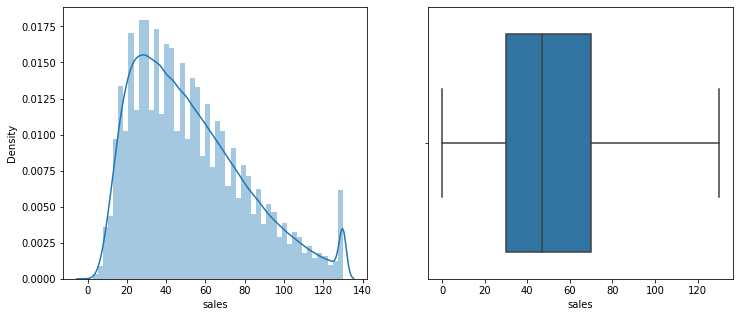

In [30]:
plt.subplots(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.distplot(dataset['sales'])
  
plt.subplot(1, 2, 2)
sns.boxplot(dataset['sales'])
plt.show()

### **TASK JAR**

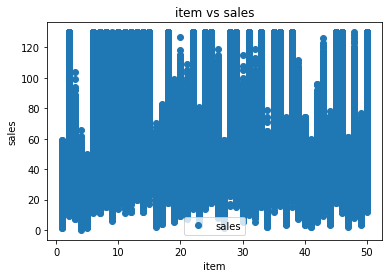

In [31]:
dataset.plot(x='item', y='sales', style='o')
plt.title('item vs sales')
plt.xlabel('item')
plt.ylabel('sales')
plt.show()

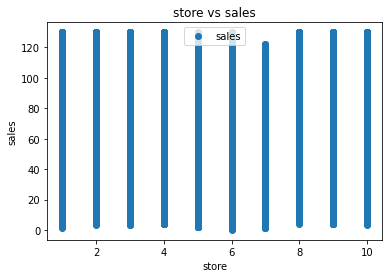

In [32]:
dataset.plot(x='store', y='sales', style='o')
plt.title('store vs sales')
plt.xlabel('store')
plt.ylabel('sales')
plt.show()

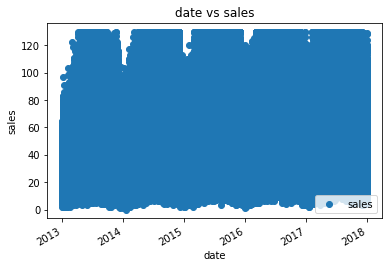

In [33]:
dataset.plot(x='date', y='sales', style='o')
plt.title('date vs sales')
plt.xlabel('date')
plt.ylabel('sales')
plt.show()

In [34]:
#Sales Data Per Item
sales_by_item = dataset.groupby('item')['sales'].sum().reset_index()
sales_by_item

,item,sales
0,1,401384.0
1,2,1069418.0
2,3,669087.0
3,4,401907.0
4,5,335230.0
5,6,1068156.0
6,7,1068743.0
7,8,1397852.0
8,9,938375.0
9,10,1333472.0


[Text(0.5, 0, 'Item Id'),
 Text(0, 0.5, 'Sum of Sales'),
 Text(0.5, 1.0, 'Total Sales Per Item')]

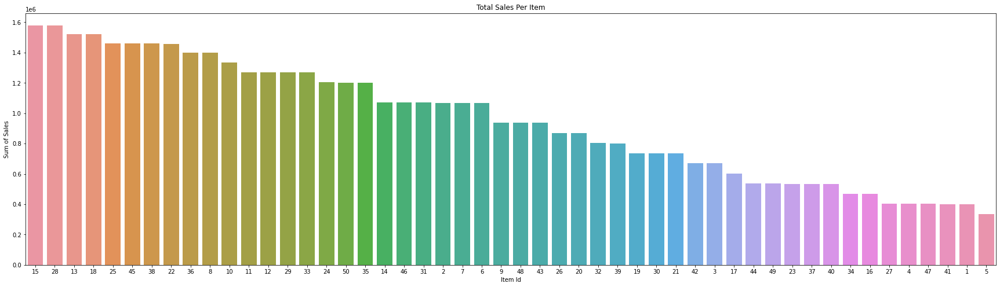

In [61]:
fig, ax = plt.subplots(figsize=(30,8))
sns.barplot(sales_by_item.item, sales_by_item.sales, order=sales_by_item.sort_values('sales', ascending = False).item)
ax.set(xlabel = "Item Id", ylabel = "Sum of Sales", title = "Total Sales Per Item")
    

In [62]:
#Sales Data Per Store
sales_by_store = dataset.groupby('store')['sales'].sum().reset_index()

[Text(0.5, 0, 'Store Id'),
 Text(0, 0.5, 'Sum of Sales'),
 Text(0.5, 1.0, 'Total Sales Per Store')]

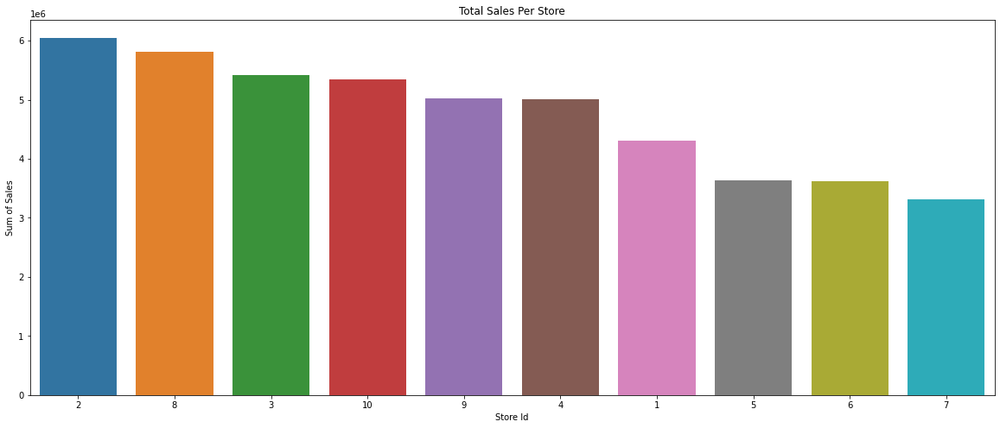

In [65]:
fig, ax = plt.subplots(figsize=(20,8))
sns.barplot(sales_by_store.store, sales_by_store.sales, order=sales_by_store.sort_values('sales',ascending = False).store)
ax.set(xlabel = "Store Id", ylabel = "Sum of Sales", title = "Total Sales Per Store")
   

Text(0, 0.5, 'Sales/store')

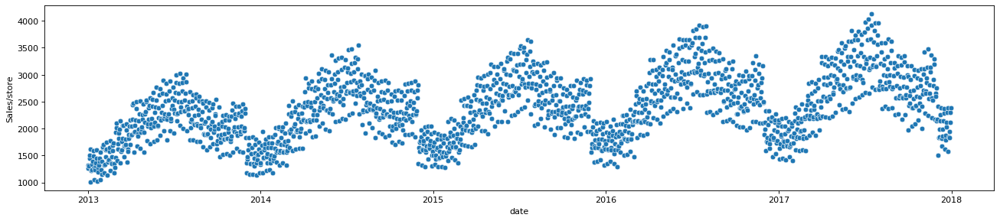

In [67]:
figure(figsize=(20, 4), dpi=80)
item_daily = dataset.groupby(["date","store"],as_index=False).agg({"sales":"sum"})

item_daily['date'] = pd.to_datetime(item_daily.date, format='%Y/%m/%d')
item_1 = item_daily[item_daily['store']==1]
ax_2 = sns.scatterplot(data=item_1,x='date',y='sales')
ax_2.set_ylabel("Sales/store")

Text(0, 0.5, 'Sales/Item_1')

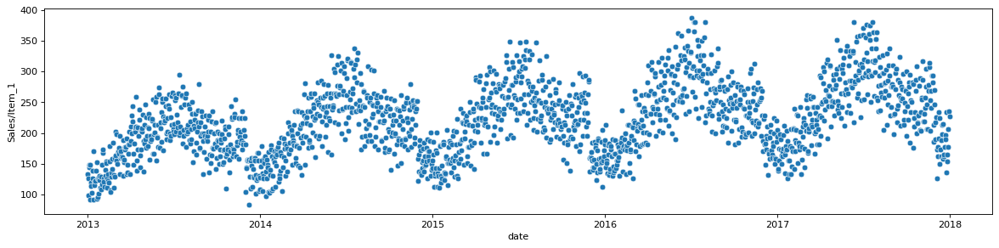

In [68]:
figure(figsize=(18, 4), dpi=80)
item_daily = dataset.groupby(["date","item"],as_index=False).agg({"sales":"sum"})

item_daily['date'] = pd.to_datetime(item_daily.date, format='%Y/%m/%d')
item_1 = item_daily[item_daily['item']==1]
ax_2 = sns.scatterplot(data=item_1,x='date',y='sales')
ax_2.set_ylabel("Sales/Item_1")

**Feature Engineering**

In [69]:
# Convert the date column to a datetime object
dataset['date'] = pd.to_datetime(dataset['date'])

In [70]:
# Create new columns for year, month, and day
dataset['year'] = dataset['date'].dt.year
dataset['month'] = dataset['date'].dt.month
dataset['day'] = dataset['date'].dt.day

In [71]:
from datetime import datetime
import calendar
      
def weekend_or_weekday(year,month,day):
      
    d = datetime(year,month,day)
    if d.weekday()>4:
        return 1
    else:
        return 0
  
dataset['weekend'] = dataset.apply(lambda x:weekend_or_weekday(x['year'], x['month'], x['day']), axis=1)
dataset.head()

,date,store,item,sales,year,month,day,weekend,weekday,holidays
0,2013-01-01,1,1,13.0,2013,1,1,0,1,0
1,2013-01-02,1,1,11.0,2013,1,2,0,2,0
2,2013-01-03,1,1,14.0,2013,1,3,0,3,0
3,2013-01-04,1,1,13.0,2013,1,4,0,4,0
4,2013-01-05,1,1,10.0,2013,1,5,1,5,0


In [45]:
def which_day(year, month, day):
      
    d = datetime(year,month,day)
    return d.weekday()
  
dataset['weekday'] = dataset.apply(lambda x: which_day(x['year'],x['month'],x['day']),axis=1)
dataset.head()

,date,store,item,sales,year,month,day,weekend,weekday
0,2013-01-01,1,1,13.0,2013,1,1,0,1
1,2013-01-02,1,1,11.0,2013,1,2,0,2
2,2013-01-03,1,1,14.0,2013,1,3,0,3
3,2013-01-04,1,1,13.0,2013,1,4,0,4
4,2013-01-05,1,1,10.0,2013,1,5,1,5


In [46]:
from datetime import date
import holidays
def is_holiday(x):
    india_holidays = holidays.country_holidays('IN')
    if india_holidays.get(x):
      return 1
    else:
      return 0
dataset['holidays'] = dataset['date'].apply(is_holiday)
dataset.head()

,date,store,item,sales,year,month,day,weekend,weekday,holidays
0,2013-01-01,1,1,13.0,2013,1,1,0,1,0
1,2013-01-02,1,1,11.0,2013,1,2,0,2,0
2,2013-01-03,1,1,14.0,2013,1,3,0,3,0
3,2013-01-04,1,1,13.0,2013,1,4,0,4,0
4,2013-01-05,1,1,10.0,2013,1,5,1,5,0


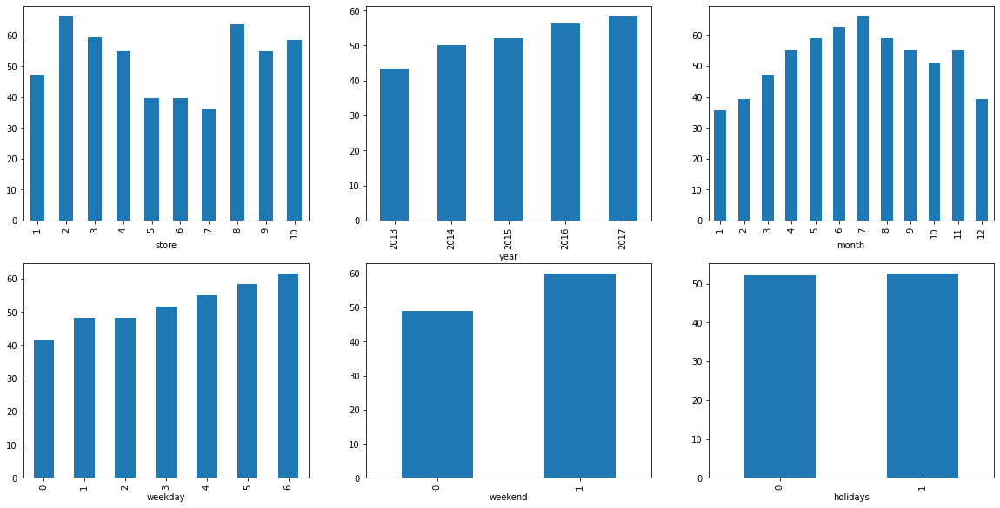

In [47]:
features = ['store', 'year', 'month',\
            'weekday', 'weekend','holidays' ]
  
plt.subplots(figsize=(20, 10))
for i, col in enumerate(features):
    plt.subplot(2, 3, i + 1)
    dataset.groupby(col).mean()['sales'].plot.bar()
plt.show()

In [48]:
item_i = dataset[dataset['item']==3]
item_i

,date,store,item,sales,year,month,day,weekend,weekday,holidays
36520,2013-01-01,1,3,15.0,2013,1,1,0,1,0
36521,2013-01-02,1,3,30.0,2013,1,2,0,2,0
36522,2013-01-03,1,3,14.0,2013,1,3,0,3,0
36523,2013-01-04,1,3,10.0,2013,1,4,0,4,0
36524,2013-01-05,1,3,23.0,2013,1,5,1,5,0
...,...,...,...,...,...,...,...,...,...,...
54775,2017-12-27,10,3,32.0,2017,12,27,0,2,0
54776,2017-12-28,10,3,33.0,2017,12,28,0,3,0
54777,2017-12-29,10,3,39.0,2017,12,29,0,4,0
54778,2017-12-30,10,3,34.0,2017,12,30,1,5,0


In [49]:
k = item_i.groupby(['date','item'])
item_1 = k.agg(sum)
item_1=item_1.reset_index()
j=[]
for i in range(89, len(item_1)):
    b = item_1['date'][0+i] # 0 is the starting date and 0+i is the end date
    j.append(b)
item = item_1.head(1737) 
item['end']=j  
date_list = dataset['date'].to_list()
d =[]
for i in range(1737):
     r = item.loc[i, 'end']
     a = date_list.index(r)
     c =item_1.loc[i:a,'sales'].sum()
     d.append(c)
item['total'] = d
item['date'] = pd.to_datetime(item['date'])
item['year'] = item['date'].dt.year
item['month'] = item['date'].dt.month
item['day'] = item['date'].dt.day

In [72]:
item

,date,item,store,sales,year,month,day,weekend,weekday,holidays,end,total
0,2013-01-01,3,55,172.0,2013,1,1,0,10,0,2013-03-31,21420.0
1,2013-01-02,3,55,213.0,2013,1,2,0,20,0,2013-04-01,21472.0
2,2013-01-03,3,55,193.0,2013,1,3,0,30,0,2013-04-02,21580.0
3,2013-01-04,3,55,218.0,2013,1,4,0,40,0,2013-04-03,21664.0
4,2013-01-05,3,55,217.0,2013,1,5,10,50,0,2013-04-04,21783.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1732,2017-09-29,3,55,423.0,2017,9,29,0,40,0,2017-12-27,35038.0
1733,2017-09-30,3,55,482.0,2017,9,30,10,50,10,2017-12-28,34913.0
1734,2017-10-01,3,55,457.0,2017,10,1,10,60,0,2017-12-29,34763.0
1735,2017-10-02,3,55,332.0,2017,10,2,0,0,10,2017-12-30,34648.0


**Split the Data**

In [74]:
x =  item.loc[:,['year','month','day']].values
y = item.loc[:,'total'].values


***Train and Test the Data***

In [75]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size =0.2)


**Scale the Data**

In [76]:
from sklearn.preprocessing import StandardScaler ## standrard scalig 
scaler = StandardScaler() #initialise to a variable
scaler.fit(x_train) # we are finding the values of mean and sd from the td
x_train = scaler.transform(x_train) # fit (mean, sd) and then transform the training data
x_test= scaler.transform(x_test) # transform the test data 

### **MODEL**

 **Linear Regression**

In [77]:
linear =LinearRegression()
linear.fit(x_train,y_train)
print('score for Linear Regression:',linear.score(x_test,y_test))

score for Linear Regression: 0.481263258730786


**Decision Tree Regressor**

In [78]:
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score

for depth in [1,2,3,4,5,6,7,8,9,10,20,40,60]:
  dt = DecisionTreeRegressor(max_depth=depth)
  dt.fit(x_train,y_train)
  trainAccuracy = r2_score(y_train,dt.predict(x_train))
  dt = DecisionTreeRegressor(max_depth = depth)
  valAccuracy = cross_val_score(dt, x_train, y_train, cv=10, scoring = make_scorer(r2_score))
  print("Depth:",depth,'Train R2:',trainAccuracy,'Val Score:',np.mean(valAccuracy))
dt = DecisionTreeRegressor(max_depth = int(input('max depth value')))
dt.fit(x_train,y_train)
#print('score for Decision Treeregressor:',dt.score(x_test,y_test))


Depth: 1 Train R2: 0.33154915135069485 Val Score: 0.3250212843731104
Depth: 2 Train R2: 0.552800020778341 Val Score: 0.5329390950804609
Depth: 3 Train R2: 0.753603961881316 Val Score: 0.7465914988299855
Depth: 4 Train R2: 0.8684687176485202 Val Score: 0.8687197941041246
Depth: 5 Train R2: 0.9366235419655043 Val Score: 0.9351137459095362
Depth: 6 Train R2: 0.965989608108881 Val Score: 0.9629418853101874
Depth: 7 Train R2: 0.9851751999869933 Val Score: 0.9824792823561571
Depth: 8 Train R2: 0.993905610722292 Val Score: 0.9912936040054063
Depth: 9 Train R2: 0.9977007125442657 Val Score: 0.9956799673632319
Depth: 10 Train R2: 0.9993043345197485 Val Score: 0.9976417074156311
Depth: 20 Train R2: 1.0 Val Score: 0.9985134546797358
Depth: 40 Train R2: 1.0 Val Score: 0.9985134546797358
Depth: 60 Train R2: 1.0 Val Score: 0.9985134546797358
max depth value9


DecisionTreeRegressor(max_depth=9)

**KNeighborsRegressor**

In [79]:
#from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
for i in [1,2,3,4,5,6,7,8,9,10,20,50]:
  knn = KNeighborsRegressor(i)
  knn.fit(x_train,y_train)
  print('k value:',i ,'train score:',knn.score(x_train,y_train),'cv score:',np.mean(cross_val_score(knn, x_train, y_train, cv=10, scoring = make_scorer(r2_score))))
knn =KNeighborsRegressor(int(input('enter k values:')))
knn.fit(x_train,y_train)
#print('score for knn regression :',knn.score(x_test,y_test))

k value: 1 train score: 1.0 cv score: 0.9984198944058758
k value: 2 train score: 0.9998473864463016 cv score: 0.9945728315304431
k value: 3 train score: 0.9989915604400351 cv score: 0.9890577137265458
k value: 4 train score: 0.996187815867456 cv score: 0.9842804098614388
k value: 5 train score: 0.9927082923718541 cv score: 0.9806355186458389
k value: 6 train score: 0.9885718309606206 cv score: 0.9786237668746003
k value: 7 train score: 0.9861848349455254 cv score: 0.9782464643174207
k value: 8 train score: 0.985049343685212 cv score: 0.9776323442849121
k value: 9 train score: 0.9849616376619695 cv score: 0.975945638442951
k value: 10 train score: 0.9832758006677431 cv score: 0.9738745575722236
k value: 20 train score: 0.9614946257612863 cv score: 0.9511004749985202
k value: 50 train score: 0.9346453442778233 cv score: 0.9251669375659549
enter k values:9


KNeighborsRegressor(n_neighbors=9)

In [80]:
!pip install -U scikit-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


**XGBRegressor**

In [81]:
from xgboost import XGBRegressor
import xgboost as xgb

for lr in [0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.1,0.11,0.12,0.13,0.14,0.15,0.2,0.5,0.7,1]:
  model = xgb.XGBRegressor(learning_rate = lr,n_estimators =100,verbosity =0)#initialise the model
  model.fit(x_train,y_train)
  model.score(x_test,y_test)
  print('Learning rate:',lr,"Train score",model.score(x_train,y_train),'Cross-Val score:',np.mean(cross_val_score(model,x_train,y_train,cv=10)))
model = xgb.XGBRegressor(learning_rate = float(input('LR value')),n_estimators =100) 
model.fit(x_train,y_train)

print('score for the XGBRegressor:',model.score(x_test,y_test))

Learning rate: 0.01 Train score -3.4930040331902728 Cross-Val score: -3.556794713786168
Learning rate: 0.02 Train score 0.37801756490949157 Cross-Val score: 0.3666665376033961
Learning rate: 0.03 Train score 0.9108188624885614 Cross-Val score: 0.9069713729760374
Learning rate: 0.04 Train score 0.9858033713697075 Cross-Val score: 0.9839806801261792
Learning rate: 0.05 Train score 0.9971284545184301 Cross-Val score: 0.9958471122206596
Learning rate: 0.06 Train score 0.9989104816267005 Cross-Val score: 0.997952823169301
Learning rate: 0.07 Train score 0.9994288047282291 Cross-Val score: 0.9984866927446664
Learning rate: 0.08 Train score 0.9996402292298493 Cross-Val score: 0.9988100643186442
Learning rate: 0.09 Train score 0.9996968427951037 Cross-Val score: 0.9990461904446393
Learning rate: 0.1 Train score 0.9998095876538814 Cross-Val score: 0.9991313663817698
Learning rate: 0.11 Train score 0.9998335421941742 Cross-Val score: 0.9992973912573475
Learning rate: 0.12 Train score 0.999865027

**Accuracy**

In [82]:
print('Score for the Linear Regressor       :',linear.score(x_test,y_test))    
print('Score for the Decision TreeRegressor :',dt.score(x_test,y_test))    
print('Score for the KNN Regressor          :',knn.score(x_test,y_test)) 
print('Score for the XGBRegressor           :',model.score(x_test,y_test))  
#print('score for the Random Forest:',RF.score(x_test,y_test))

Score for the Linear Regressor       : 0.481263258730786
Score for the Decision TreeRegressor : 0.9952989427134794
Score for the KNN Regressor          : 0.9803240354612992
Score for the XGBRegressor           : 0.9990122695373498


In [83]:
linear_pred = linear.predict(x_test)
dt_pred= dt.predict(x_test)
knn_pred=knn.predict(x_test)
xgb_pred=model.predict(x_test)

In [84]:
pd.DataFrame({"Actual":y_test, "linear_pred":linear_pred,"dt_pred":dt_pred, "knn_pred":knn_pred,"xgb_pred":xgb_pred })

,Actual,linear_pred,dt_pred,knn_pred,xgb_pred
0,32752.0,30251.272634,32664.750000,32945.777778,32626.472656
1,28433.0,34108.964249,28530.500000,29446.555556,28467.394531
2,24485.0,26785.286259,24349.000000,24854.000000,24372.669922
3,38705.0,33797.689583,39299.192308,38463.333333,38559.472656
4,37552.0,37467.709857,37950.000000,38099.333333,37475.328125
...,...,...,...,...,...
343,33300.0,28994.606450,33274.041667,33024.666667,33243.773438
344,31711.0,27874.948686,31729.600000,31378.666667,31882.089844
345,25778.0,31682.205064,25852.166667,26768.666667,25746.246094
346,42739.0,36117.208002,42559.460000,42380.555556,42780.097656


**Awaiting for Comments:** To know how to do deployment 